In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/chicago-crimes-2008-2022.csv')

In [ ]:
df

In [ ]:
df.isnull().sum()

#**Seaborn**

<Axes: title={'center': 'Número de crimes ao passar dos dias'}, xlabel='Dias', ylabel='Crimes'>

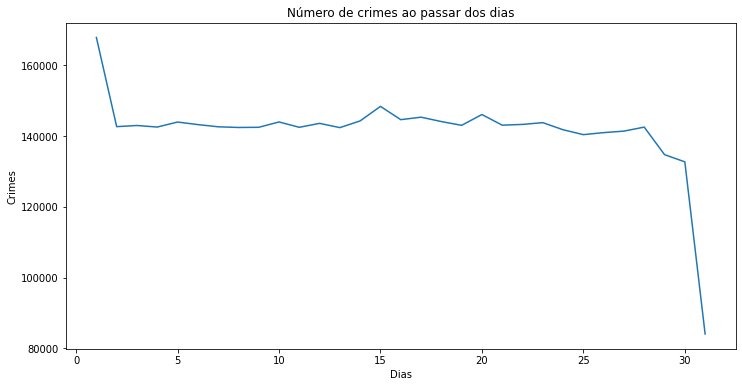

In [ ]:
plt.figure(figsize=[12, 6])
plt.title('Número de crimes ao passar dos dias')
plt.ylabel('Crimes')
plt.xlabel('Dias')
sns.lineplot(x=df['Day'].value_counts().index,y=df['Day'].value_counts().values)

<Axes: title={'center': 'Número de crimes ao passar dos meses'}, xlabel='Mês', ylabel='Crimes'>

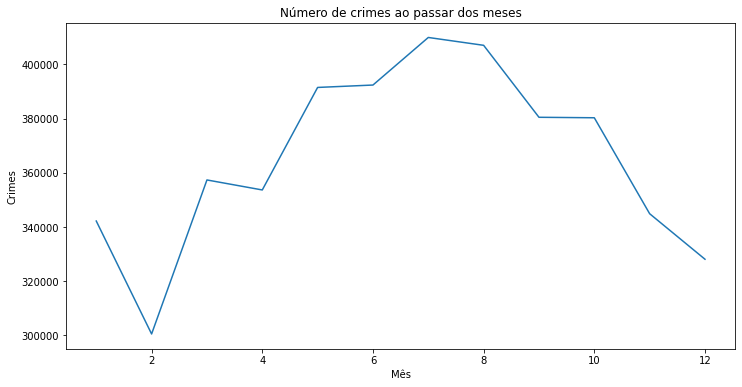

In [ ]:
plt.figure(figsize=[12, 6])
plt.title('Número de crimes ao passar dos meses')
plt.ylabel('Crimes')
plt.xlabel('Mês')
sns.lineplot(x=df['Month'].value_counts().index,y=df['Month'].value_counts().values)

<Axes: title={'center': 'Número de crimes ao passar dos anos'}, xlabel='Ano', ylabel='Crimes'>

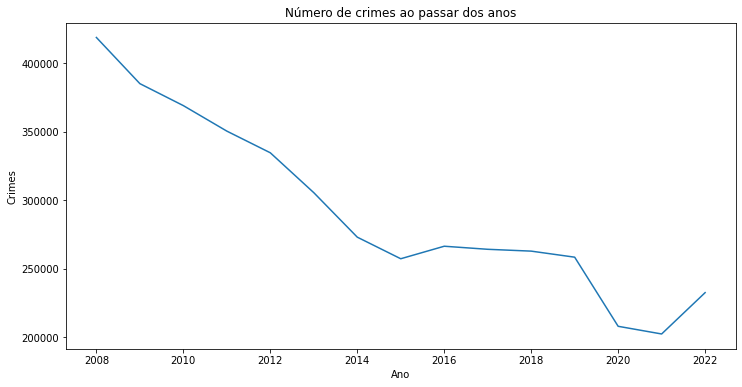

In [ ]:
plt.figure(figsize=[12, 6])
plt.title('Número de crimes ao passar dos anos')
plt.ylabel('Crimes')
plt.xlabel('Ano')
sns.lineplot(x=df['Year'].value_counts().index,y=df['Year'].value_counts().values)

<Axes: title={'center': 'Número de crimes ao passar das horas'}, xlabel='Horas', ylabel='Crimes'>

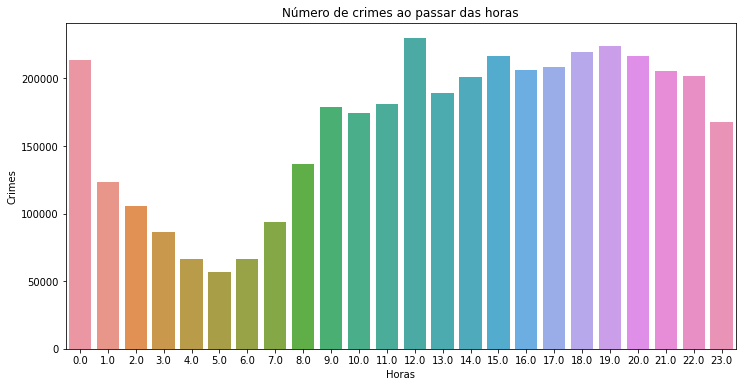

In [ ]:
plt.figure(figsize=[12, 6])
plt.title('Número de crimes ao passar das horas')
plt.ylabel('Crimes')
plt.xlabel('Horas')
sns.barplot(x=df['Time'].value_counts().index,y=df['Time'].value_counts().values)

<Axes: title={'center': 'Top 5 crimes'}, xlabel='Crimes'>

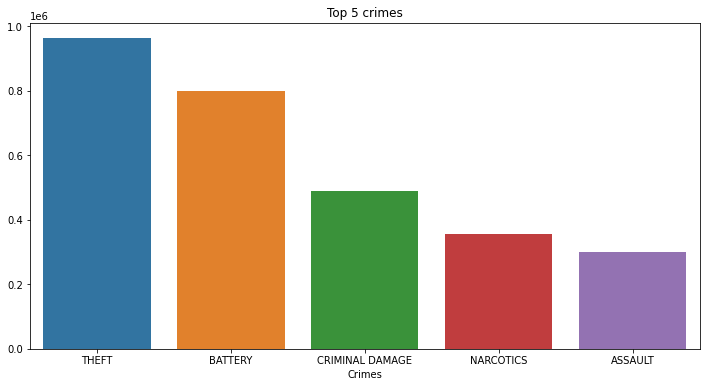

In [ ]:
plt.figure(figsize=[12, 6])
plt.title('Top 5 crimes')
plt.ylabel('')
plt.xlabel('Crimes')
sns.barplot(x= df['Category'].value_counts().index[:5], y = df['Category'].value_counts().values[0:5])

In [ ]:
dias = {
    'Sunday':0,
    'Monday':1,
    'Tuesday':2,
    'Wednesday':3,
    'Thursday':4,
    'Friday':5,
    'Saturday':6
}

contagemDias = df['DayOfWeek'].value_counts().rename(index=dias).sort_index()
contagemDias

0    603902
1    620172
2    623894
3    628604
4    621632
5    659139
6    631021
Name: DayOfWeek, dtype: int64

<Axes: title={'center': 'Número de crimes por dia da semana (0 como domingo)'}, xlabel='Dias', ylabel='Crimes'>

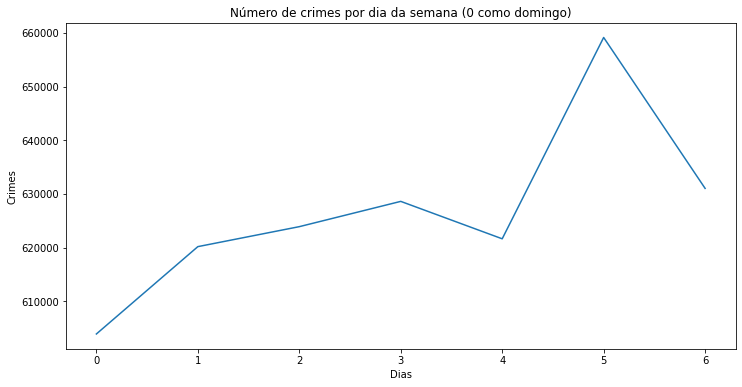

In [ ]:
plt.figure(figsize=[12, 6])
plt.title('Número de crimes por dia da semana (0 como domingo)')
plt.ylabel('Crimes')
plt.xlabel('Dias')
sns.lineplot(x=contagemDias.index,y=contagemDias.values)

In [ ]:
newDf = df.filter(['Year','Month','Category'], axis=1)
newDfff = pd.DataFrame(columns= ['Year', 'Month', 'Count'])
for i in range(2008, 2023):
  index = df.index
  index = index[df['Year'] == i].tolist()
  train = newDf.iloc[index, :]
  
  newDff = pd.DataFrame(columns= ['Year', 'Month', 'Count'])
  newDff['Year'] = np.ones(12) * i
  newDff['Month'] = train['Month'].value_counts().index
  newDff['Count'] = train['Month'].value_counts().values
  newDfff = pd.concat([newDff, newDfff])

tabela_pivot = newDfff.pivot_table(index='Year', columns='Month', values = 'Count')
tabela_pivot

Month,1,2,3,4,5,6,7,8,9,10,11,12
Year,,,,,,,,,,,,
2008.0,32684.0,28170.0,33526.0,34948.0,37397.0,37092.0,39699.0,39754.0,36816.0,37210.0,32748.0,28712.0
2009.0,29530.0,27682.0,33005.0,32040.0,34731.0,33765.0,35084.0,35076.0,33289.0,32271.0,30885.0,27703.0
2010.0,29045.0,24839.0,32212.0,31569.0,33299.0,32609.0,33400.0,34037.0,31766.0,32282.0,28815.0,25148.0
2011.0,27022.0,22155.0,28578.0,28986.0,31478.0,32179.0,33134.0,32482.0,29818.0,30152.0,27511.0,26923.0
2012.0,26071.0,23762.0,28428.0,27087.0,29970.0,30942.0,31863.0,29931.0,27646.0,27846.0,25940.0,25111.0
2013.0,25264.0,21298.0,24825.0,25393.0,27853.0,27222.0,28481.0,28507.0,26210.0,25318.0,23403.0,21719.0
2014.0,19691.0,17878.0,22009.0,22731.0,24698.0,25235.0,26374.0,25642.0,23671.0,23777.0,20565.0,20760.0
2015.0,20354.0,16101.0,21321.0,21221.0,23175.0,22627.0,23661.0,24202.0,22428.0,22337.0,19853.0,19994.0
2016.0,20405.0,18527.0,21826.0,20933.0,23303.0,23786.0,24556.0,24625.0,23392.0,23470.0,21475.0,20108.0


<ErrorbarContainer object of 3 artists>

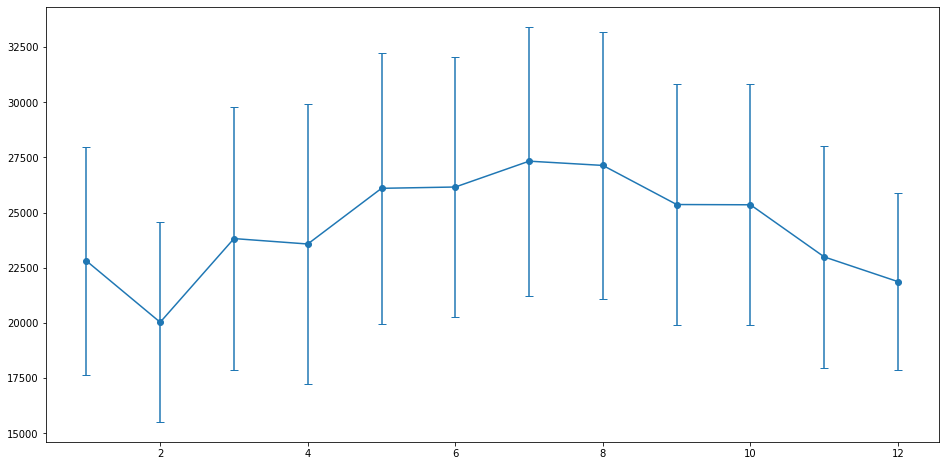

In [ ]:
plt.figure(figsize=(16,8))                                                  
plt.errorbar(x=tabela_pivot.mean(axis=0).index, y=tabela_pivot.mean(axis=0).values, yerr=tabela_pivot.std(axis=0), fmt='-o', capsize= 4.0)

#**Folium e GeoPandas**

In [ ]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import geopandas as gpd

In [ ]:
from shapely.geometry import Point

In [ ]:
mapa = gpd.read_file('/content/drive/MyDrive/SF Find Neighborhoods.zip (Unzipped Files)/geo_export_1e0a72d7-85f1-4091-924b-eb8389c0d1d7.shp')
mapa.crs = 'EPSG:7131'
mapa

,link,name,geometry
0,"http://en.wikipedia.org/wiki/Sea_Cliff,_San_Fr...",Seacliff,"POLYGON ((-122.493 37.784, -122.494 37.787, -1..."
1,NaN,Lake Street,"POLYGON ((-122.487 37.784, -122.487 37.786, -1..."
2,http://www.nps.gov/prsf/index.htm,Presidio National Park,"POLYGON ((-122.478 37.811, -122.477 37.811, -1..."
3,NaN,Presidio Terrace,"POLYGON ((-122.472 37.787, -122.471 37.788, -1..."
4,http://www.sfgate.com/neighborhoods/sf/innerri...,Inner Richmond,"POLYGON ((-122.473 37.786, -122.467 37.787, -1..."
...,...,...,...
112,"http://en.wikipedia.org/wiki/Corona_Heights,_S...",Corona Heights,"POLYGON ((-122.435 37.763, -122.435 37.763, -1..."
113,http://en.wikipedia.org/wiki/Haight-Ashbury,Ashbury Heights,"POLYGON ((-122.452 37.761, -122.452 37.762, -1..."
114,"http://en.wikipedia.org/wiki/Eureka_Valley,_Sa...",Eureka Valley,"POLYGON ((-122.437 37.762, -122.437 37.759, -1..."
115,"http://en.wikipedia.org/wiki/St._Francis_Wood,...",St. Francis Wood,"POLYGON ((-122.472 37.735, -122.468 37.737, -1..."


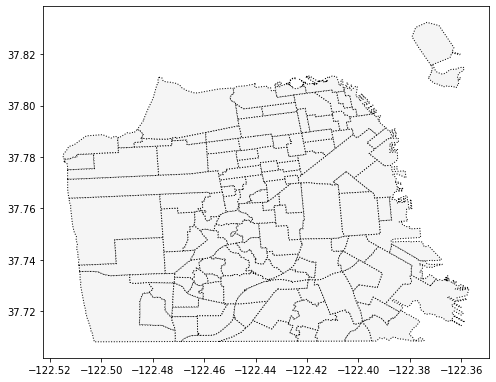

In [ ]:
ax = mapa.plot(figsize=(8,8), color='whitesmoke', linestyle=':', edgecolor='black')

In [ ]:
import folium
from folium.plugins import HeatMap, MarkerCluster

In [ ]:
mapa1 = folium.Map(location = [41.88666249341458, -87.62759383026999  ], tiles='stamentoner',zoom_start= 12.4)

In [ ]:
mapa1

In [ ]:
### separando para consumir menos memória e obter a visualização ###

In [ ]:
df['Year'].value_counts()

2008    418756
2009    385061
2010    369021
2011    350418
2012    334597
2013    305493
2014    273031
2016    266406
2017    264171
2018    262832
2019    258416
2015    257274
2022    232537
2020    207977
2021    202374
Name: Year, dtype: int64

In [ ]:
df2017 = df.loc[df['Year'].isin([2017])].reset_index().drop(['index'], axis = 1)
df2017_12 = df2017.loc[df['Month'].isin([12])].reset_index().drop(['index'], axis = 1)

In [ ]:
df2017_12.shape

(19996, 10)

In [ ]:
HeatMap(
    data = df2017_12[['Latitude', 'Longitude']],
).add_to(mapa1)

In [ ]:
mapa1

In [ ]:
mapa2 = folium.Map(location = [41.88666249341458, -87.62759383026999  ], tiles='stamentoner',zoom_start= 12.4)
mapa2

In [ ]:
for i in range(len(df2017_12)):
  folium.Circle(
      location = [df2017_12.loc[i].Latitude, df2017_12.loc[i].Longitude],
      radius= 10,
      color = 'darkred'
  ).add_to(mapa2)

In [ ]:
mapa2

In [ ]:
mapa3 = folium.Map(location = [41.88666249341458, -87.62759383026999  ], tiles='stamentoner',zoom_start= 12.4)

In [ ]:
mc = MarkerCluster()

for index, row in df2017_12.iterrows():
  mc.add_child(folium.Marker([row['Latitude'], row['Longitude']]))
mapa3.add_child(mc)

Text(0, 0.5, 'Latitude')

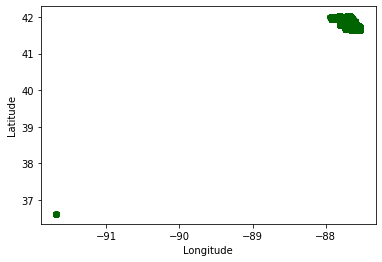

In [ ]:
plt.scatter(df.Longitude, df.Latitude,
            c = 'darkgreen', marker = 'p')
plt.xlabel('Longitude')
plt.ylabel('Latitude')